# Gene-Level Curve Fitting and Feature Correlation Analysis

## Overview

This notebook performs comprehensive correlation analysis between **curve fitting parameters** extracted from time-resolved fitness data and **genomic/proteomic features** of S. pombe genes.

### Background
- **Curve fitting**: Gompertz function was used to model time-resolved fitness data, extracting three key parameters:
  - **A**: Asymptotic fitness level (final growth capacity)
  - **um**: Maximum growth rate 
  - **lam**: Lag phase duration (time to reach maximum growth rate)

### Objectives
1. Load and explore curve fitting results and gene feature datasets
2. Perform correlation analysis between curve parameters and gene features
3. Create comprehensive scatter plots to visualize relationships
4. Identify significant biological patterns and associations
5. Summarize key findings with statistical significance

### Data Sources
- **Curve fitting data**: `Gene_level_statistics_fitted.csv` - Contains A, um, lam parameters from Gompertz fitting
- **Gene features**: `collected_pombe_gene_features.csv` - Contains comprehensive gene annotations and molecular properties


In [1]:
"""
Gene-Level Curve Fitting and Feature Correlation Analysis

This script analyzes correlations between curve fitting parameters (A, um, lam) 
and various genomic/proteomic features of S. pombe genes.
"""

import logging
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from typing import List, Dict, Tuple, Optional, Union
from scipy import stats
from scipy.stats import pearsonr, spearmanr, gaussian_kde
import warnings
warnings.filterwarnings('ignore')

# Set up logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

# Define color palette (following cursor rules)
colors = {
    'primary': ['#962955', '#7fb775', '#6479cc', '#ad933c'],  # Purple, Green, Blue, Golden brown
    'extended': ['#962955', '#7fb775', '#6479cc', '#ad933c', '#26b1fd', '#8c397b'],
    'neutral': ['#89afba', '#d59e67', '#723916']
}

# Set global plotting parameters
plt.rcParams.update({
    'figure.max_open_warning': 0,
    'font.family': 'sans-serif',
    'font.sans-serif': ['Arial'],
    'font.size': 10,
    'axes.linewidth': 1.2,
    'axes.spines.top': False,
    'axes.spines.right': False,
    'grid.alpha': 0.3,
    'grid.linewidth': 0.8
})

# Color palette following cursor rules
COLOR_PALETTE = {
    'primary_purple': '#962955',
    'primary_green': '#7fb775', 
    'primary_blue': '#6479cc',
    'primary_gold': '#ad933c',
    'fit_line': '#962955',
    'data_points': '#6479cc',
    'constraint_lines': '#333333'
}

print("Libraries imported successfully!")
print(f"Working directory: {Path.cwd()}")
print(f"Matplotlib backend: {plt.get_backend()}")


Libraries imported successfully!
Working directory: /data/c/yangyusheng_optimized/DIT_HAP_pipeline/workflow/notebooks
Matplotlib backend: module://matplotlib_inline.backend_inline


## Data Loading and Initial Exploration

We'll start by loading both datasets and examining their structure and content to understand what features are available for correlation analysis.


2025-07-29 12:56:16,094 - INFO - Loading curve fitting data from: ../../results/HD_DIT_HAP/18_gene_level_curve_fitting/Gene_level_statistics_fitted.tsv
2025-07-29 12:56:16,113 - INFO - Loading gene features data from: ../../resources/pombase_data/collected_pombe_gene_features.csv
2025-07-29 12:56:16,165 - INFO - Curve data shape: (4519, 26)
2025-07-29 12:56:16,166 - INFO - Gene features shape: (5134, 42)


=== CURVE FITTING DATA ===
Shape: (4519, 26)
Columns: ['Name', 'FYPOviability', 'DeletionLibrary_essentiality', 'time_points', 'Status', 'A', 'um', 'lam', 'R2', 'RMSE', 'normalized_RMSE', 't0', 't1', 't2', 't3', 't4', 't0_fitted', 't1_fitted', 't2_fitted', 't3_fitted', 't4_fitted', 't0_residual', 't1_residual', 't2_residual', 't3_residual', 't4_residual']

First few rows:
                   A     um   lam     R2   RMSE   Status
Systematic ID                                           
SPAC1002.02    0.177 -0.021  0.00 -0.462  0.136  Success
SPAC1002.03c   0.253  0.025  0.00  0.253  0.127  Success
SPAC1002.04c   8.686  0.730  2.65  0.997  0.142  Success
SPAC1002.05c   0.116 -0.010  0.00 -0.747  0.104  Success
SPAC1002.06c  -0.134 -0.023 -0.00  0.207  0.052  Success

=== GENE FEATURES DATA ===
Shape: (5134, 42)
Columns: ['Gene_name', 'Gene_product', 'uniprot_id', 'FYPOviability', 'Transcript', 'Chr', 'Start', 'End', 'Strand', 'gene_gc_content', 'start_codon', 'stop_codon', 'start_codon_le

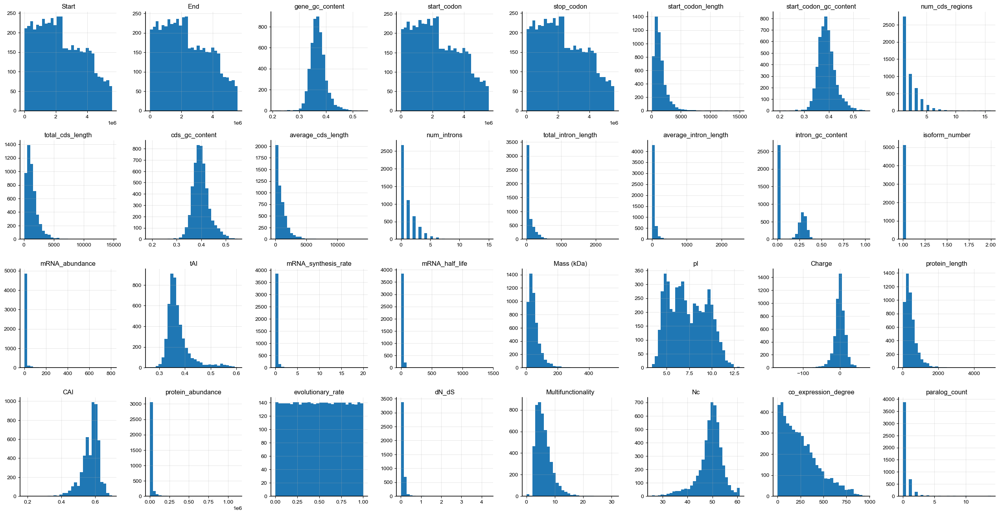

In [2]:
def load_and_explore_data() -> Tuple[pd.DataFrame, pd.DataFrame]:
    """
    Load curve fitting results and gene features data.
    
    Returns:
        Tuple of (curve_data, gene_features) DataFrames
    """
    # Define file paths
    curve_data_path = Path("../../results/HD_DIT_HAP/18_gene_level_curve_fitting/Gene_level_statistics_fitted.tsv")
    gene_features_path = Path("../../resources/pombase_data/collected_pombe_gene_features.csv")
    
    # Load curve fitting data
    logging.info(f"Loading curve fitting data from: {curve_data_path}")
    curve_data = pd.read_csv(curve_data_path, sep="\t")
    curve_data.set_index('Systematic ID', inplace=True)
    
    # Load gene features data
    logging.info(f"Loading gene features data from: {gene_features_path}")
    gene_features = pd.read_csv(gene_features_path)
    gene_features.set_index('Systematic_ID', inplace=True)
    
    logging.info(f"Curve data shape: {curve_data.shape}")
    logging.info(f"Gene features shape: {gene_features.shape}")
    
    return curve_data, gene_features

# Load the data
curve_data, gene_features = load_and_explore_data()

gene_clusters = pd.read_excel("../../resources/20250317_plateau_GWMs.xlsx")
WT_cluster_genes = gene_clusters.query("revised_cluster == 'WT'")["Systematic ID"].tolist()

# curve_data = curve_data[~curve_data.index.isin(WT_cluster_genes)].copy()

print("=== CURVE FITTING DATA ===")
print(f"Shape: {curve_data.shape}")
print(f"Columns: {list(curve_data.columns)}")
print("\nFirst few rows:")
print(curve_data[['A', 'um', 'lam', 'R2', 'RMSE', 'Status']].head())

print("\n=== GENE FEATURES DATA ===")
print(f"Shape: {gene_features.shape}")
print(f"Columns: {list(gene_features.columns)}")
print("\nFirst few rows:")
print(gene_features[['Gene_name', 'FYPOviability', 'protein_length', 'mRNA_abundance']].head())
# histogram

gene_features.hist(bins=30, figsize=(32, 16), layout=(4, 8))
plt.show()
plt.close()


In [3]:
def gompertz_function(x: np.ndarray, A: float, um: float, lam: float) -> np.ndarray:
    """
    Calculate Gompertz function values with numerical stability.
    
    Args:
        x: Input time points
        A: Maximum depletion level (asymptote)
        um: Maximum depletion rate
        lam: Lag time parameter
        
    Returns:
        Gompertz function values at input points
    """
    # Check for division by zero
    if A == 0:
        return np.zeros_like(x)
    
    exponent = np.clip((um * np.e / A) * (lam - x) + 1, -700, 700)
    return A * np.exp(-np.exp(exponent))

def create_fitted_plot(ax: plt.Axes, x_values: np.ndarray, y_values: np.ndarray, 
                      params: Dict[str, Union[str, float]], ID: str) -> None:
    """
    Create a publication-quality plot for fitted curve.
    
    Args:
        ax: Matplotlib axes object
        x_values: Time points
        y_values: Depletion measurements
        params: Fitted parameters
        ID: Gene/insertion identifier
    """
    ax.grid(True, alpha=0.3)
    
    if params['Status'] == 'Success':
        A, um, lam = params['A'], params['um'], params['lam']
        
        # Plot data points
        ax.scatter(x_values, y_values, 
                  color=COLOR_PALETTE['data_points'], 
                  s=50, alpha=0.8, 
                  edgecolors='white', linewidth=0.5,
                  label='Data')
        
        # Plot fitted curve
        x_smooth = np.linspace(min(x_values), max(x_values), 100)
        y_fit = gompertz_function(x_smooth, A, um, lam)
        ax.plot(x_smooth, y_fit, 
               color=COLOR_PALETTE['fit_line'], 
               linewidth=2.0, label='Fitted')
        
        # Add constraint lines with subtle styling
        ax.axhline(y=A, color=COLOR_PALETTE['constraint_lines'], 
                  linestyle='--', alpha=0.3, linewidth=1.0)
        ax.axvline(x=lam, color=COLOR_PALETTE['constraint_lines'], 
                  linestyle='--', alpha=0.3, linewidth=1.0)
        # add the straight line that crosses with the x axis at x=lam, and with the slope of um
        x_line = np.linspace(lam-1, 14, 100)
        y_line = um * (x_line - lam)
        ax.plot(x_line, y_line, color=COLOR_PALETTE['constraint_lines'], linestyle='--', alpha=0.3, linewidth=1.0)
        
        # Add parameter text
        # param_text = f'A={A:.2f}    R²={params["R2"]:.3f}\num={um:.2f}  RMSE={params["RMSE"]:.3f}\nlam={lam:.2f}    NRMSE={params["normalized_RMSE"]:.3f}'
        # ax.text(0.05, 0.95, param_text, 
        #        transform=ax.transAxes, fontsize=8,
        #        verticalalignment='top')
    else:
        # Plot failed fit
        ax.scatter(x_values, y_values, 
                  color='gray', s=30, alpha=0.6)
        ax.text(0.5, 0.5, 'Fit Failed', 
               transform=ax.transAxes, fontsize=10,
               horizontalalignment='center', color='red')
    
    ax.set_ylim(-1.5, 8.5)
    ax.set_title(" ".join(ID.split("=")), fontsize=9, pad=5)
    ax.tick_params(labelsize=8)

In [4]:
fig, axes = plt.subplots(1, 5, figsize=(24, 4), sharex=True, sharey=True)

labels = {
    "SPAC1002.16c": "tna1",
    "SPAC23C11.15": "pst2",
    "SPAC13G6.09": "tsr402",
    "SPAC1002.08c": "mtf1",
    "SPBC1773.10c": "nrs1",
}

for idx, (sysID, gene) in enumerate(labels.items()):
    ax = axes[idx]
    x = np.array([0.0, 2.352, 5.588, 9.104, 12.48])
    y = curve_data.loc[sysID, :][["t0", "t1", "t2", "t3", "t4"]].values
    A, um, lam = curve_data.loc[sysID, :][["A", "um", "lam"]].values
    ax.scatter(x, y,
                  s=200, alpha=0.8, color="#d7674f")
        
    # Plot fitted curve
    x_smooth = np.linspace(min(x), max(x), 100)
    y_fit = gompertz_function(x_smooth, A, um, lam)
    ax.plot(x_smooth, y_fit, color="#698dda",
            linewidth=5, alpha=1)

    # add the straight line that crosses with the x axis at x=lam, and with the slope of um
    # ax.axhline(y=A, color="#b674cf", 
    #               linestyle='--', alpha=0.8, linewidth=3)
    ax.axvline(x=lam, color="#5baa4d", 
                  linestyle='--', alpha=0.8, linewidth=3)
        # add the straight line that crosses with the x axis at x=lam, and with the slope of um
    x_line = np.linspace(lam-1, 14, 100)
    y_line = um * (x_line - lam)
    ax.plot(x_line, y_line, color="#dd5f92", linestyle='--', alpha=0.8, linewidth=4)
    ax.set_ylim(-1.5, 8)
    ax.tick_params(labelsize=14, labelleft=True, labelbottom=True)
    if idx == 0:
        ax.set_xlabel("Generation", fontsize=16)
        ax.set_ylabel("Log2 Fold Change", fontsize=16)
    ax.legend(frameon=False, fontsize=6)
    ax.set_title(gene, fontsize=20, fontstyle='italic', fontweight='bold')
# plt.show()
plt.tight_layout()
plt.savefig("gene_examples.pdf", dpi=300, bbox_inches='tight', transparent=True)
plt.close()

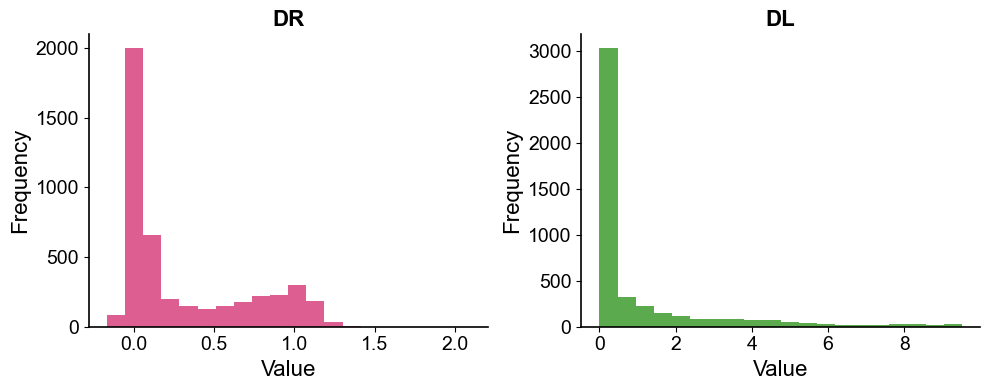

In [5]:
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
feature_colors = {
    "um": "#dd5f92",
    "lam": "#5baa4d"
}
for idx, feature in enumerate(["um", "lam"]):
    ax = axes[idx]
    ax.hist(curve_data[feature], bins=20, color=feature_colors[feature])
    if feature == "um":
        ax.set_title("DR", fontsize=16, fontweight='bold')
    elif feature == "lam":
        ax.set_title("DL", fontsize=16, fontweight='bold')
    ax.set_xlabel("Value", fontsize=16)
    ax.set_ylabel("Frequency", fontsize=16)
    ax.tick_params(labelsize=14)
plt.tight_layout()
plt.show()
# plt.savefig("gene_examples.pdf", dpi=300, bbox_inches='tight', transparent=True)
plt.close()

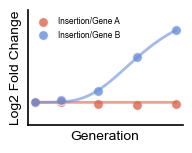

In [8]:
fig, ax = plt.subplots(figsize=(2, 1.5))

colors = {
    3: "#d7674f",
    6: "#698dda"
}

labels = {
    3: "Insertion/Gene A",
    6: "Insertion/Gene B"
}

for i in [3, 6]:
    x = np.array([0.0, 2.352, 5.588, 9.104, 12.48])
    y = curve_data.iloc[i, :][["t0", "t1", "t2", "t3", "t4"]].values
    A, um, lam = curve_data.iloc[i, :][["A", "um", "lam"]].values
    ax.scatter(x, y, 
                  color=colors[i], 
                  s=50, alpha=0.8, 
                  edgecolors='white', linewidth=0.8,
                  label=labels[i])
        
    # Plot fitted curve
    x_smooth = np.linspace(min(x), max(x), 100)
    y_fit = gompertz_function(x_smooth, A, um, lam)
    ax.plot(x_smooth, y_fit, 
            color=colors[i], 
            linewidth=2.0, alpha=0.6)
ax.set_ylim(-1.5, 6)
ax.tick_params(labelsize=8, labelleft=False, labelbottom=False, left=False, bottom=False)
ax.set_xlabel("Generation", fontsize=10)
ax.set_ylabel("Log2 Fold Change", fontsize=10)
ax.legend(frameon=False, fontsize=6)
plt.show()
# plt.savefig("test.svg", dpi=300, bbox_inches='tight', transparent=True)
plt.close()

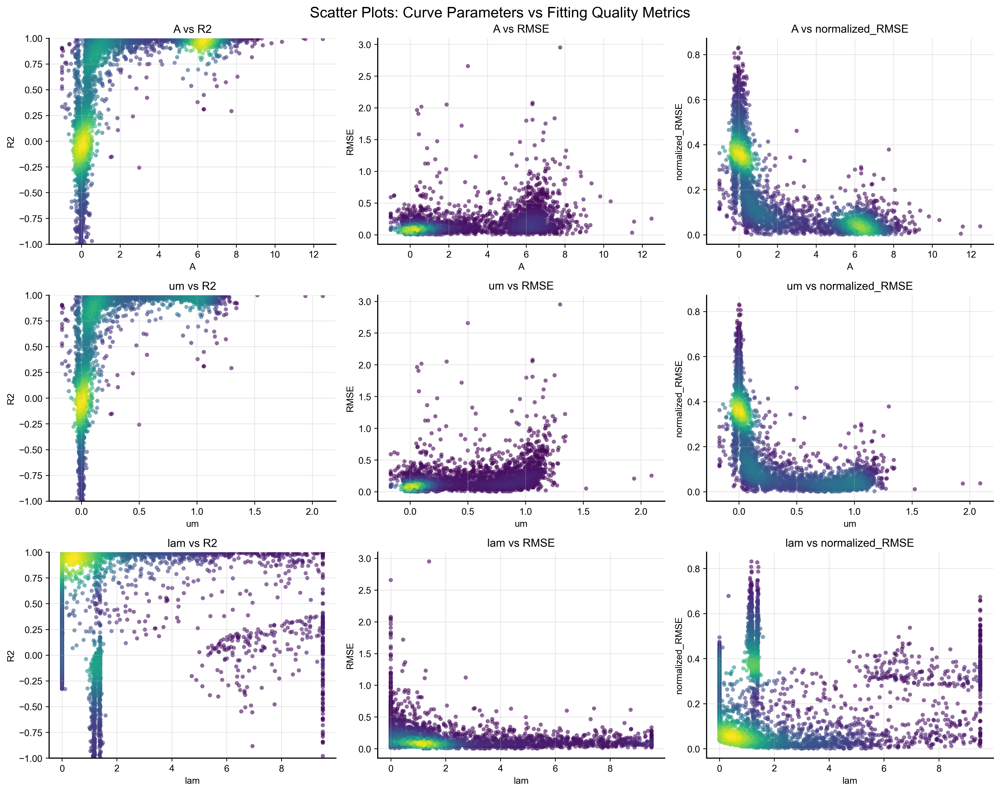

In [7]:
# Create scatter plots between curve fitting parameters
fig, axes = plt.subplots(3, 3, figsize=(15, 12))
fig.suptitle('Scatter Plots: Curve Parameters vs Fitting Quality Metrics', fontsize=16)

# Define X and Y variables
x_vars = ['A', 'um', 'lam']
y_vars = ['R2', 'RMSE', 'normalized_RMSE']

# Create scatter plots
for i, x_var in enumerate(x_vars):
    for j, y_var in enumerate(y_vars):
        ax = axes[i, j]
        
        # Filter out any missing values
        mask = ~(curve_data[x_var].isna() | curve_data[y_var].isna())
        x_data = curve_data.loc[mask, x_var]
        y_data = curve_data.loc[mask, y_var]

        x_data, y_data = x_data[x_data.notna() & y_data.notna()], y_data[x_data.notna() & y_data.notna()]
        
        xy = np.vstack([x_data, y_data])
        z = gaussian_kde(xy)(xy)
        
        # Create scatter plot
        ax.scatter(x_data, y_data, alpha=0.6, s=20, c=z, cmap='viridis', edgecolors='none')
        ax.set_xlabel(x_var)
        ax.set_ylabel(y_var)
        ax.set_title(f'{x_var} vs {y_var}')
        ax.grid(True, alpha=0.3)
        if y_var == 'R2':
            ax.set_ylim(-1, 1)

plt.tight_layout()
plt.show()
plt.close()


In [3]:
def safe_log_transform(data, feature, method='log10'):
    """Safely apply log transformation"""
    
    # Handle zeros and negatives
    if (data[feature] <= 0).any():
        # Add small constant (pseudo-count)
        min_positive = data[data[feature] > 0][feature].min()
        pseudo_count = min_positive / 10
        transformed = np.log10(data[feature] + pseudo_count)
    else:
        transformed = np.log10(data[feature])
    
    return transformed

def prepare_correlation_data(curve_data: pd.DataFrame, gene_features: pd.DataFrame, log_transform: dict[str, bool]) -> pd.DataFrame:
    """
    Merge curve fitting and gene features data, preparing for correlation analysis.
    
    Args:
        curve_data: DataFrame with curve fitting parameters
        gene_features: DataFrame with gene features
        
    Returns:
        Merged DataFrame ready for correlation analysis
    """
    # Define curve features of interest
    curve_features = ['A', 'um', 'lam', 'R2', 'RMSE', 'normalized_RMSE']
    
    # Select numeric gene features for correlation analysis
    numeric_features = gene_features.select_dtypes(include=[np.number]).columns.tolist()
    
    # Remove features with too many missing values (>50%)
    # valid_features = []
    # for col in numeric_features:
    #     missing_pct = gene_features[col].isna().sum() / len(gene_features)
    #     if missing_pct < 0.5:  # Keep features with <50% missing values
    #         valid_features.append(col)
    
    # logging.info(f"Selected {len(valid_features)} numeric gene features with <50% missing values")

    valid_features = numeric_features
    
    # make a new dataframe with the valid features for proper transformation
    valid_features_df = gene_features[valid_features].copy()

    for feature in valid_features:
        if feature in log_transform and log_transform[feature]:
            valid_features_df[feature] = safe_log_transform(valid_features_df, feature)

    # Merge datasets on Systematic ID
    merged_data = curve_data[curve_features].merge(
        valid_features_df, 
        left_index=True, 
        right_index=True, 
        how='inner'
    )
    
    # Filter for successful curve fits only
    merged_data = merged_data[curve_data['Status'] == 'Success'].copy()
    
    logging.info(f"Merged dataset shape: {merged_data.shape}")
    logging.info(f"Genes with successful curve fits: {len(merged_data)}")
    
    return merged_data, curve_features, valid_features_df.columns.tolist()

log_transform = {
    'mRNA_abundance': True,
    'tAI': False,
    'mRNA_synthesis_rate': True,
    'mRNA_half_life': True,
    'Mass (kDa)': True,
    'pI': False,
    'Charge': False,
    'protein_length': True,
    'CAI': False,
    'protein_abundance': True,
    'evolutionary_rate': False,
    'dN_dS': True,
    'Multifunctionality': False,
    'Nc': False,
    'co_expression_degree': False,
    'paralog_count': False
}

# Prepare data for correlation analysis
merged_data, curve_features, gene_feature_list = prepare_correlation_data(curve_data, gene_features, log_transform)

curve_features = ['A', 'um', 'lam']


gene_feature_list = [
    'mRNA_abundance',
    'tAI',
    'mRNA_synthesis_rate',
    'mRNA_half_life',
    'Mass (kDa)',
    'pI',
    'Charge',
    'protein_length',
    'CAI',
    'protein_abundance',
    'evolutionary_rate',
    'dN_dS',
    'Multifunctionality',
    'Nc',
    'co_expression_degree',
    'paralog_count'
]


print(f"Final merged dataset shape: {merged_data.shape}")
print(f"Curve features: {curve_features}")
print(f"Number of gene features: {len(gene_feature_list)}")
print(f"Sample gene features: {gene_feature_list[:10]}")

# Display basic statistics
print("\n=== CURVE PARAMETER STATISTICS ===")
print(merged_data[curve_features].describe().round(4))


NameError: name 'curve_data' is not defined

## Comprehensive Correlation Analysis

Now we'll compute correlations between each curve fitting parameter (A, um, lam) and all available gene features. We'll use both Pearson and Spearman correlations to capture linear and monotonic relationships.


In [9]:
def calculate_correlations(data: pd.DataFrame, curve_features: List[str], 
                          gene_features: List[str]) -> Dict[str, pd.DataFrame]:
    """
    Calculate Pearson and Spearman correlations between curve and gene features.
    
    Args:
        data: Merged DataFrame with both curve and gene features
        curve_features: List of curve parameter names
        gene_features: List of gene feature names
        
    Returns:
        Dictionary containing correlation matrices and p-values
    """
    results = {}
    
    # Focus on main curve parameters for correlation analysis
    main_curve_features = ['A', 'um', 'lam']
    
    for curve_param in main_curve_features:
        pearson_corrs = []
        pearson_pvals = []
        spearman_corrs = []
        spearman_pvals = []
        valid_features = []
        
        for gene_feature in gene_features:
            # Remove rows where either value is NaN
            valid_data = data[[curve_param, gene_feature]].dropna()
            
            if len(valid_data) < 10:  # Skip if too few data points
                continue
                
            valid_features.append(gene_feature)
            
            # Calculate Pearson correlation
            pearson_r, pearson_p = pearsonr(valid_data[curve_param], valid_data[gene_feature])
            pearson_corrs.append(pearson_r)
            pearson_pvals.append(pearson_p)
            
            # Calculate Spearman correlation
            spearman_r, spearman_p = spearmanr(valid_data[curve_param], valid_data[gene_feature])
            spearman_corrs.append(spearman_r)
            spearman_pvals.append(spearman_p)
        
        # Create results DataFrame
        corr_df = pd.DataFrame({
            'gene_feature': valid_features,
            'pearson_r': pearson_corrs,
            'pearson_p': pearson_pvals,
            'spearman_r': spearman_corrs,
            'spearman_p': spearman_pvals,
            'n_samples': [len(data[[curve_param, feat]].dropna()) for feat in valid_features]
        })
        
        # Add significance indicators
        corr_df['pearson_sig'] = corr_df['pearson_p'] < 0.05
        corr_df['spearman_sig'] = corr_df['spearman_p'] < 0.05
        
        # Sort by absolute Pearson correlation
        corr_df['abs_pearson_r'] = np.abs(corr_df['pearson_r'])
        corr_df = corr_df.sort_values('abs_pearson_r', ascending=False)
        
        results[curve_param] = corr_df
        
        logging.info(f"Calculated correlations for {curve_param}: {len(corr_df)} valid gene features")
    
    return results

# Calculate correlations
correlation_results = calculate_correlations(merged_data, curve_features, gene_feature_list)

# Display top correlations for each parameter
for param in ['A', 'um', 'lam']:
    print(f"\n=== TOP 10 CORRELATIONS FOR {param.upper()} ===")
    top_corrs = correlation_results[param].head(10)
    display_cols = ['gene_feature', 'pearson_r', 'pearson_p', 'spearman_r', 'spearman_p', 'n_samples']
    print(top_corrs[display_cols].round(4))


2025-06-11 09:13:13,293 - INFO - Calculated correlations for A: 16 valid gene features
2025-06-11 09:13:13,347 - INFO - Calculated correlations for um: 16 valid gene features


2025-06-11 09:13:13,404 - INFO - Calculated correlations for lam: 16 valid gene features



=== TOP 10 CORRELATIONS FOR A ===
            gene_feature  pearson_r  pearson_p  spearman_r  spearman_p  \
10     evolutionary_rate    -0.1870     0.0000     -0.1887      0.0000   
11                 dN_dS    -0.1691     0.0000     -0.1667      0.0000   
2    mRNA_synthesis_rate     0.1332     0.0000      0.1443      0.0000   
15         paralog_count    -0.1294     0.0000     -0.1360      0.0000   
0         mRNA_abundance     0.1115     0.0000      0.0925      0.0000   
3         mRNA_half_life     0.1069     0.0000      0.1112      0.0000   
9      protein_abundance     0.0839     0.0005      0.0785      0.0012   
14  co_expression_degree     0.0746     0.0006      0.0790      0.0003   
12    Multifunctionality     0.0648     0.0028      0.0833      0.0001   
1                    tAI     0.0535     0.0132      0.0614      0.0044   

    n_samples  
10       2006  
11       1895  
2        1842  
15       2115  
0        2151  
3        1842  
9        1705  
14       2135  
12    

## Visualization: Correlation Heatmaps

Let's create heatmaps to visualize the correlation patterns between curve parameters and gene features. This will help identify clusters of related features and overall correlation strength.


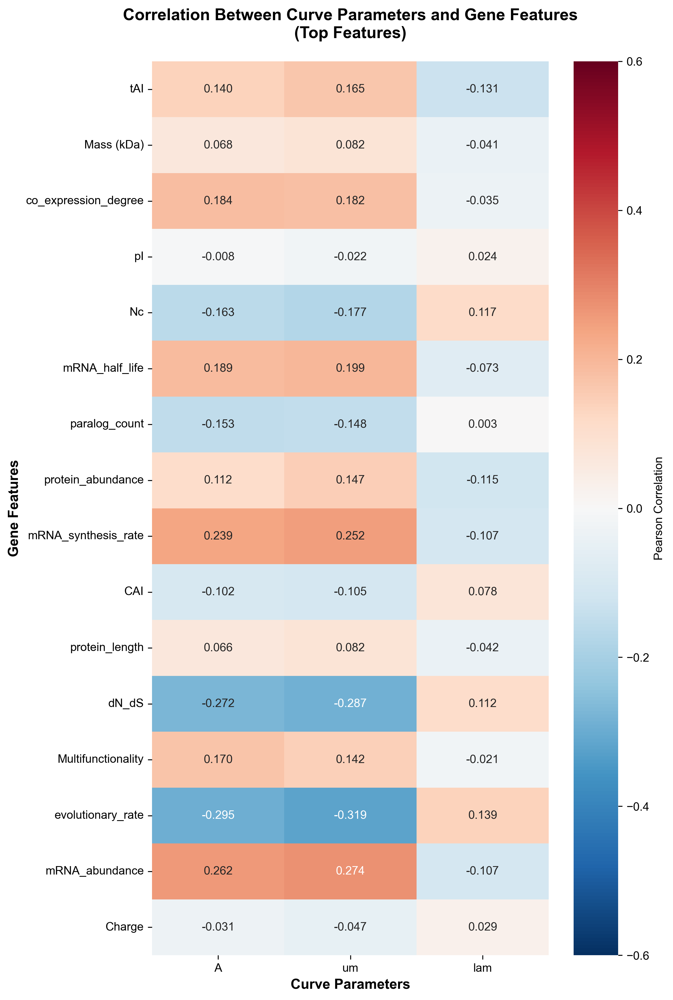

In [28]:
def create_correlation_heatmap(correlation_results: Dict[str, pd.DataFrame], 
                              top_n: int = 20) -> None:
    """
    Create heatmap showing correlations between curve parameters and top gene features.
    
    Args:
        correlation_results: Dictionary with correlation results for each curve parameter
        top_n: Number of top features to display for each parameter
    """
    # Collect top features for each parameter
    all_top_features = set()
    for param in ['A', 'um', 'lam']:
        top_features = correlation_results[param].head(top_n)['gene_feature'].tolist()
        all_top_features.update(top_features)
    
    all_top_features = list(all_top_features)
    
    # Create correlation matrix
    correlation_matrix = pd.DataFrame(index=all_top_features, columns=['A', 'um', 'lam'])
    
    for param in ['A', 'um', 'lam']:
        param_corrs = correlation_results[param].set_index('gene_feature')
        for feature in all_top_features:
            if feature in param_corrs.index:
                correlation_matrix.loc[feature, param] = param_corrs.loc[feature, 'pearson_r']
            else:
                correlation_matrix.loc[feature, param] = np.nan
    
    # Convert to numeric
    correlation_matrix = correlation_matrix.astype(float)
    
    # Create the heatmap
    fig, ax = plt.subplots(figsize=(8, 12))
    
    # Create mask for missing values
    mask = correlation_matrix.isna()
    
    # Plot heatmap
    sns.heatmap(correlation_matrix, 
                mask=mask,
                annot=True, 
                fmt='.3f',
                cmap='RdBu_r',
                center=0,
                vmin=-0.6, 
                vmax=0.6,
                square=False,
                cbar_kws={'label': 'Pearson Correlation'},
                ax=ax)
    
    ax.set_title('Correlation Between Curve Parameters and Gene Features\n(Top Features)', 
                 fontsize=14, fontweight='bold', pad=20)
    ax.set_xlabel('Curve Parameters', fontsize=12, fontweight='bold')
    ax.set_ylabel('Gene Features', fontsize=12, fontweight='bold')
    
    plt.tight_layout()
    plt.show()

# Create correlation heatmap
create_correlation_heatmap(correlation_results, top_n=15)


## Detailed Scatter Plot Analysis

Now we'll create detailed scatter plots for the most significant correlations. This will allow us to visualize the actual relationships and identify any outliers or non-linear patterns.


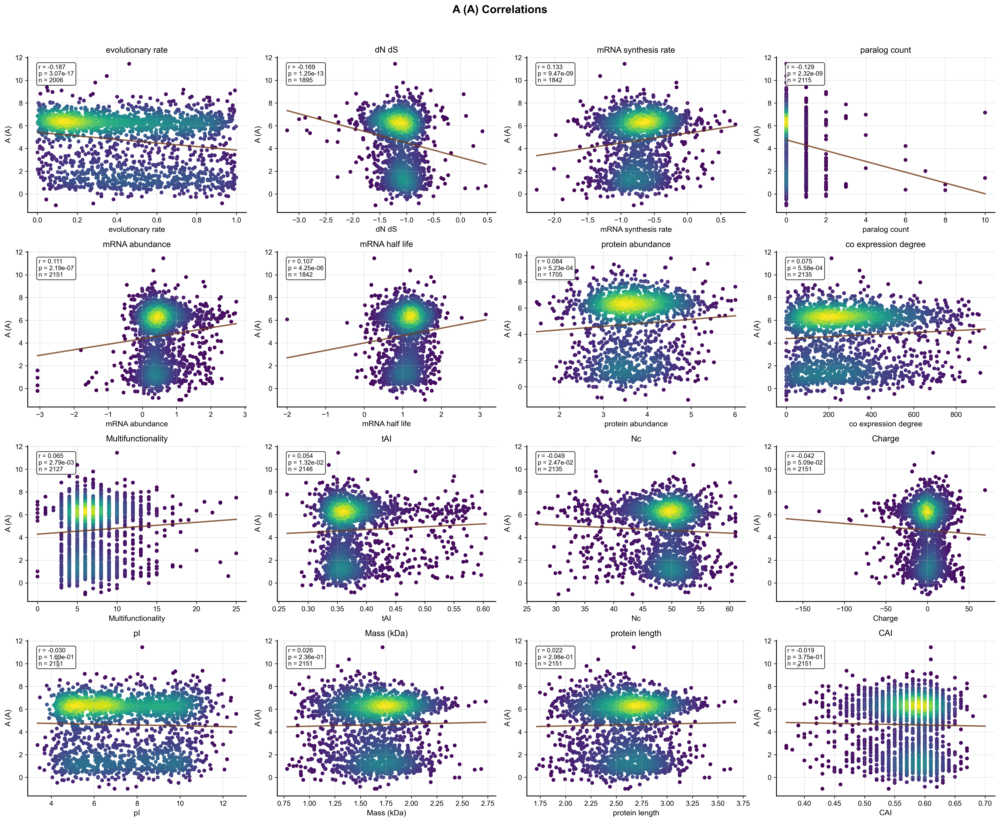

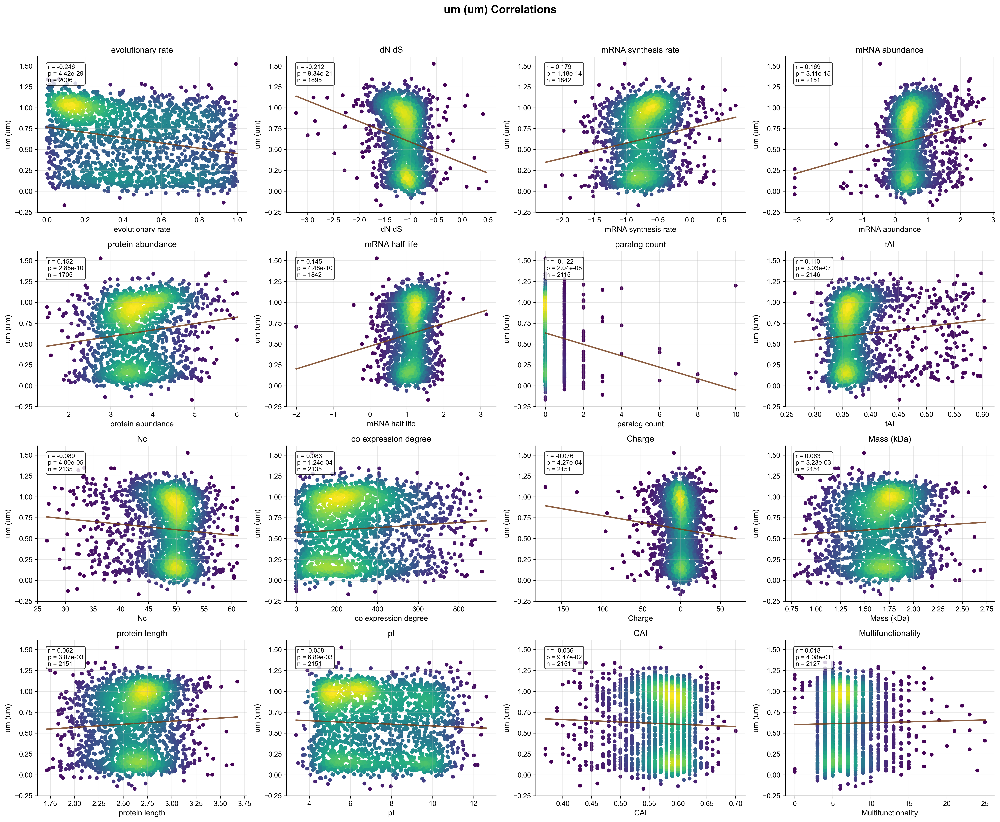

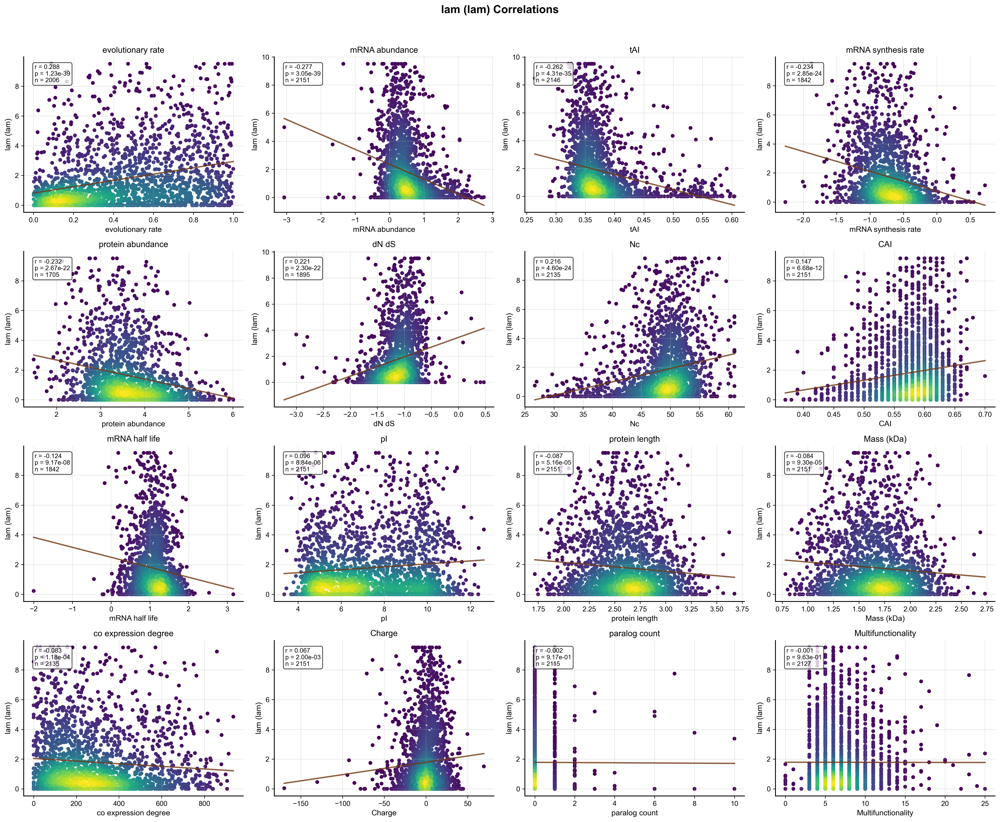

In [11]:
def create_scatter_plots(data: pd.DataFrame, correlation_results: Dict[str, pd.DataFrame], 
                        n_plots: int = 3) -> None:
    """
    Create scatter plots for the top correlations of each curve parameter.
    
    Args:
        data: Merged DataFrame with curve and gene features
        correlation_results: Dictionary with correlation results
        n_plots: Number of top correlations to plot for each parameter
    """
    curve_params = ['A', 'um', 'lam']
    param_descriptions = {
        'A': 'A',
        'um': 'um', 
        'lam': 'lam'
    }
    
    for i, param in enumerate(curve_params):
        # Get top correlations
        top_corrs = correlation_results[param].head(n_plots)

        n_cols = 4
        n_rows = n_plots//n_cols + (1 if n_plots%n_cols > 0 else 0)
        
        # Create subplot
        fig, axes = plt.subplots(n_rows, n_cols, figsize=(5*n_cols, 4*n_rows))
        if n_plots == 1:
            axes = [axes]
        else:
            axes = axes.flatten()
        
        fig.suptitle(f'{param_descriptions[param]} ({param}) Correlations', 
                     fontsize=16, fontweight='bold', y=1.02)
        
        for j, (_, row) in enumerate(top_corrs.iterrows()):
            gene_feature = row['gene_feature']
            pearson_r = row['pearson_r']
            pearson_p = row['pearson_p']
            n_samples = row['n_samples']
            
            # Get clean data for plotting
            plot_data = data[[param, gene_feature]].dropna()
            
            # Create scatter plot
            ax = axes[j]

            x = plot_data[gene_feature]
            y = plot_data[param]
            xy = np.vstack([x, y])
            z = stats.gaussian_kde(xy)(xy)
            ax.scatter(x, y, c=z, s=30, edgecolors="none")
            
            # Add trend line
            if len(plot_data) > 1:
                z = np.polyfit(plot_data[gene_feature], plot_data[param], 1)
                p = np.poly1d(z)
                x_trend = np.linspace(plot_data[gene_feature].min(), 
                                    plot_data[gene_feature].max(), 100)
                ax.plot(x_trend, p(x_trend), color=colors['neutral'][2], 
                       linewidth=2, alpha=0.8)
            
            # Format axes
            ax.set_xlabel(gene_feature.replace('_', ' '), fontsize=11)
            ax.set_ylabel(f'{param} ({param_descriptions[param]})', fontsize=11)
            ax.grid(True, alpha=0.3)
            ax.set_title(f'{gene_feature.replace("_", " ")}', fontsize=12)
            
            # Add correlation statistics
            stats_text = f'r = {pearson_r:.3f}\np = {pearson_p:.2e}\nn = {n_samples}'
            ax.text(0.05, 0.95, stats_text, transform=ax.transAxes, 
                   verticalalignment='top', fontsize=9,
                   bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8))
        
        plt.tight_layout()
        plt.show()
        plt.close()

# Create scatter plots for top 3 correlations of each parameter
create_scatter_plots(merged_data, correlation_results, n_plots=len(gene_feature_list))


## Biological Context Analysis

Let's examine correlations in the context of gene essentiality and functional categories to understand the biological significance of our findings.


In [ ]:
def analyze_by_essentiality(data: pd.DataFrame, gene_features: pd.DataFrame) -> None:
    """
    Analyze curve parameters by gene essentiality groups.
    
    Args:
        data: Merged DataFrame with curve parameters
        gene_features: Original gene features DataFrame
    """
    # Merge with essentiality information
    essentiality_data = data.merge(
        gene_features[['FYPOviability']], 
        left_index=True, right_index=True, how='left'
    )
    
    # Create essentiality groups
    essential_genes = essentiality_data[essentiality_data['FYPOviability'] == 'inviable']
    viable_genes = essentiality_data[essentiality_data['FYPOviability'] == 'viable']
    
    print(f"Essential genes: {len(essential_genes)}")
    print(f"Viable genes: {len(viable_genes)}")
    
    # Compare distributions
    fig, axes = plt.subplots(1, 3, figsize=(15, 4))
    curve_params = ['A', 'um', 'lam']
    param_descriptions = {
        'A': 'Asymptotic Fitness Level',
        'um': 'Maximum Growth Rate', 
        'lam': 'Lag Phase Duration'
    }
    
    for i, param in enumerate(curve_params):
        ax = axes[i]
        
        # Create box plots
        data_to_plot = [
            essential_genes[param].dropna(),
            viable_genes[param].dropna()
        ]
        
        box_parts = ax.boxplot(data_to_plot, labels=['Essential', 'Viable'], 
                              patch_artist=True, notch=True)
        
        # Color the boxes
        box_parts['boxes'][0].set_facecolor(colors['primary'][0])  # Essential: Purple
        box_parts['boxes'][1].set_facecolor(colors['primary'][1])  # Viable: Green
        
        ax.set_title(f'{param_descriptions[param]} ({param})', fontweight='bold')
        ax.set_ylabel(param)
        ax.grid(True, alpha=0.3)
        
        # Add statistical test
        from scipy.stats import mannwhitneyu
        if len(data_to_plot[0]) > 0 and len(data_to_plot[1]) > 0:
            stat, p_val = mannwhitneyu(data_to_plot[0], data_to_plot[1], alternative='two-sided')
            ax.text(0.5, 0.95, f'Mann-Whitney U p = {p_val:.2e}', 
                   transform=ax.transAxes, ha='center', va='top',
                   bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8))
    
    plt.suptitle('Curve Parameters by Gene Essentiality', fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Analyze by essentiality
analyze_by_essentiality(merged_data, gene_features)


In [ ]:
def generate_comprehensive_summary(correlation_results: Dict[str, pd.DataFrame]) -> pd.DataFrame:
    """
    Generate a comprehensive summary of correlation analysis with multiple testing correction.
    
    Args:
        correlation_results: Dictionary with correlation results for each curve parameter
        
    Returns:
        DataFrame with comprehensive summary statistics
    """
    from statsmodels.stats.multitest import multipletests
    
    # Combine all results
    all_results = []
    
    for param in ['A', 'um', 'lam']:
        param_results = correlation_results[param].copy()
        param_results['curve_parameter'] = param
        all_results.append(param_results)
    
    combined_results = pd.concat(all_results, ignore_index=True)
    
    # Apply multiple testing correction
    _, combined_results['pearson_p_corrected'], _, _ = multipletests(
        combined_results['pearson_p'], method='fdr_bh'
    )
    _, combined_results['spearman_p_corrected'], _, _ = multipletests(
        combined_results['spearman_p'], method='fdr_bh'
    )
    
    # Add significance after correction
    combined_results['pearson_sig_corrected'] = combined_results['pearson_p_corrected'] < 0.05
    combined_results['spearman_sig_corrected'] = combined_results['spearman_p_corrected'] < 0.05
    
    # Sort by absolute correlation strength
    combined_results = combined_results.sort_values('abs_pearson_r', ascending=False)
    
    return combined_results

def create_summary_table(summary_results: pd.DataFrame, top_n: int = 20) -> None:
    """
    Create and display a formatted summary table.
    
    Args:
        summary_results: Comprehensive summary DataFrame
        top_n: Number of top results to display
    """
    print("=== TOP CORRELATIONS ACROSS ALL PARAMETERS (FDR-corrected) ===\n")
    
    # Select top results
    top_results = summary_results.head(top_n)
    
    # Create display table
    display_cols = [
        'curve_parameter', 'gene_feature', 'pearson_r', 'pearson_p_corrected',
        'spearman_r', 'spearman_p_corrected', 'n_samples', 'pearson_sig_corrected'
    ]
    
    display_table = top_results[display_cols].copy()
    display_table.columns = [
        'Curve Param', 'Gene Feature', 'Pearson r', 'Pearson p (FDR)', 
        'Spearman r', 'Spearman p (FDR)', 'N Samples', 'Significant'
    ]
    
    # Format for display
    for col in ['Pearson r', 'Spearman r']:
        display_table[col] = display_table[col].round(4)
    
    for col in ['Pearson p (FDR)', 'Spearman p (FDR)']:
        display_table[col] = display_table[col].apply(lambda x: f"{x:.2e}")
    
    print(display_table.to_string(index=False))
    
    # Summary statistics
    print(f"\n=== SUMMARY STATISTICS ===")
    print(f"Total correlations tested: {len(summary_results)}")
    print(f"Significant Pearson correlations (FDR < 0.05): {summary_results['pearson_sig_corrected'].sum()}")
    print(f"Significant Spearman correlations (FDR < 0.05): {summary_results['spearman_sig_corrected'].sum()}")
    
    # By parameter
    for param in ['A', 'um', 'lam']:
        param_data = summary_results[summary_results['curve_parameter'] == param]
        sig_count = param_data['pearson_sig_corrected'].sum()
        print(f"Significant correlations for {param}: {sig_count}")

# Generate comprehensive summary
summary_results = generate_comprehensive_summary(correlation_results)

# Create and display summary table
create_summary_table(summary_results, top_n=25)
